<img style="width: 200px" src="https://github.com/dbbs-lab/bsb/raw/d91532e3dc615dd5d2f23e4bbbc04df18e9cd09f/docs/images/bsb.png"></img>

# Goals

* Set up a new BSB project.
* Create a toy network to get familiar with configuration concepts.
* Use the Allen Mouse Brain Atlas to reconstruct a volume.
* Morphologies
* Connectivity
* Simulation


# Run after kernel restarts

In [ ]:
%cd my_model
from bsb.core import from_storage
from bsb.plotting import plot_network, plot_morphology
from bsb.morphologies import Morphology

# Install requirements

In [ ]:
!pip install bsb==4.0.0a50

# Create a new project

Open the [Getting Started](https://bsb.readthedocs.io/en/latest/usage/getting-started.html) guide. Then start a new project:

In [1]:
!bsb new my_model --quickstart
%cd my_model

Created 'my_model' project structure.
/mnt/c/Users/pwd06/git/bsb-introduction-notebook/my_model


Explore the project structure:

* `network_configuration.yaml` is the **configuration file**. In here you will declare your model using [YAML](https://docs.ansible.com/ansible/latest/reference_appendices/YAMLSyntax.html) syntax. (JSON is also available if you add the ``--json`` flag to the ``bsb new`` command).
* ``pyproject.toml`` is required to indicate the root of the project, and contains the project settings.
* The generated Python files contain the suggested layout for code organization of a BSB project.

The quickstart created a model with a single layer and an example cell type, we can compile it to take a look:

In [2]:
!bsb compile --clear

The ``compile`` command instructs the BSB to run a reconstruction workflow based on the components we declared in our configuration file. 

**Note:** The ``--clear`` flag clears out existing data from the network. Other options are ``--append`` or ``--redo``. Leaving out the flag while data already exists will lead to an error. 

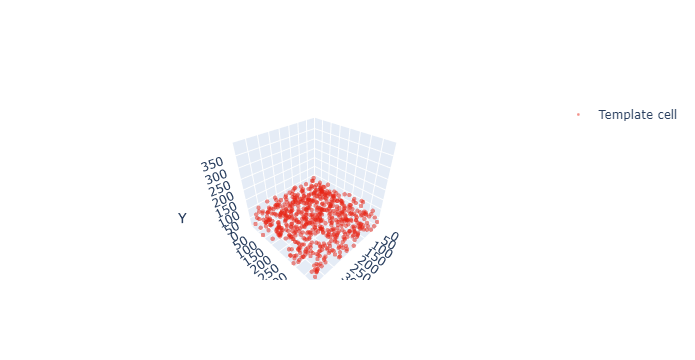

In [3]:
from bsb.core import from_storage
from bsb.plotting import plot_network

netw = from_storage("network.hdf5")
plot_network(netw);

# Create a 2-layer topology

1. Duplicate the `network_configuration.yaml`, call it `2layer.yaml`.
2. Change the `storage.root` attribute to `2layer.hdf5` so that your models write to different files.
3. Add the top layer ``partitions.top_layer``:
```yaml
partitions:
  top_layer:
    type: layer
    thickness: 100
    stack_index: 1
```
4. Add a region to stack the layers ``regions.layer_stack``:
```yaml
regions:
  layer_stack:
    type: stack
    children:
    - bottom_layer
    - top_layer
```
5. Add a cell type ``cell_types.top_type``:
```yaml
cell_types:
  top_type:
    spatial:
      radius: 7
      count: 10
```
6. Add a placement block ``placement.top_placement`` to place the ``top_type`` in the ``top_layer`` with:
```yaml
placement:
  top_placement:
    strategy: bsb.placement.RandomPlacement
    partitions:
    - top_layer
    cell_types:
    - top_type
```

In [4]:
!bsb compile 2layer.yaml --clear

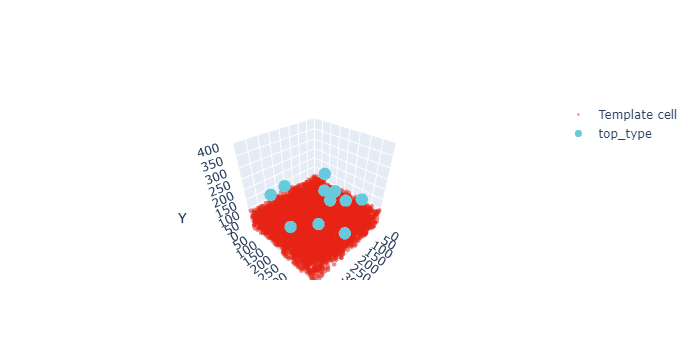

In [5]:
layered = from_storage("2layer.hdf5")
plot_network(layered);

# Create an atlas-based topology

1. Duplicate the `network_configuration.yaml` again, call it `atlas.yaml`, and configure the network storage filename to `atlas.hdf5`. 
2. Pick an Allen structure ID that you like. Here are some examples: `MOp2/3`, `SSs4`, `VISp1`, `PL2`, `ACB`, `IMB`, `FN`.
3. Replace the ``partitions.base_layer`` with an Allen structure partition:
```yaml
partitions:
  FN:
    type: allen
    struct_name: FN
```
4. Replace ``placement.example_placement.partitions`` with ``FN`` (or whichever name you gave your new partition)
5. Reduce the cell density a hundred-fold in ``cell_types.base_type.spatial.density``

In [7]:
!bsb compile atlas.yaml --clear

Traceback (most recent call last):
  File "/home/robin/.pyenv/versions/b4py9/bin/bsb", line 8, in <module>
    sys.exit(handle_cli())
  File "/mnt/c/Users/pwd06/git/bsb/bsb/cli/__init__.py", line 10, in handle_cli
    handle_command(sys.argv[1:], exit=True)
  File "/mnt/c/Users/pwd06/git/bsb/bsb/cli/__init__.py", line 30, in handle_command
    namespace.handler(namespace, dryrun=dryrun)
  File "/mnt/c/Users/pwd06/git/bsb/bsb/cli/commands/__init__.py", line 97, in execute_handler
    self.handler(context)
  File "/mnt/c/Users/pwd06/git/bsb/bsb/cli/commands/_commands.py", line 136, in handler
    network.resize(context.x, context.y, context.z)
  File "/mnt/c/Users/pwd06/git/bsb/bsb/core.py", line 244, in resize
    self.topology.do_layout(
  File "/mnt/c/Users/pwd06/git/bsb/bsb/topology/region.py", line 43, in do_layout
    layout = self.get_layout(hint)
  File "/mnt/c/Users/pwd06/git/bsb/bsb/topology/region.py", line 39, in get_layout
    layouts = [dep.get_layout(hint) for dep in self.

Cells placed: 194347


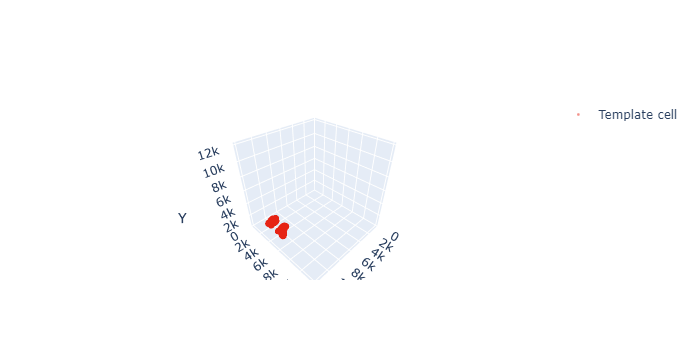

In [9]:
netw = from_storage("atlas.hdf5")
print("Cells placed:", len(netw.get_placement_set("base_type")))
plot_network(netw);

# Morphologies and pipelines

Go to [NeuroMorpho](https://neuromorpho.org/byregion.jsp) and pick an interesting looking morphology, or use the provided example file.

['axon', 'dendrites', 'soma']


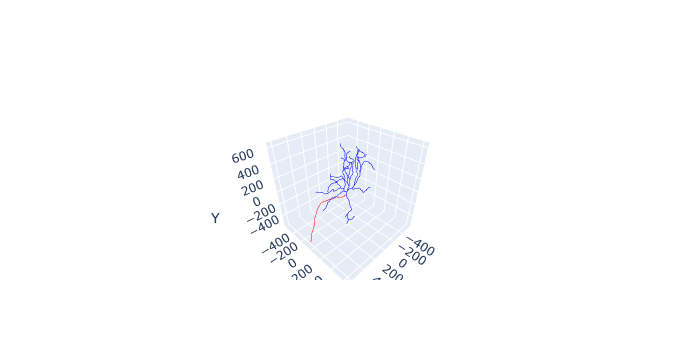

In [10]:
!cp ../morpho.swc ./morpho.swc

from bsb.morphologies import Morphology
from bsb.plotting import plot_morphology

morpho = Morphology.from_swc("morpho.swc")
print(morpho.list_labels())
plot_morphology(morpho, color={"soma": "black", "dendrites": "blue", "axon": "red"});

You can also subselect based on the ``labels`` of the morphology:

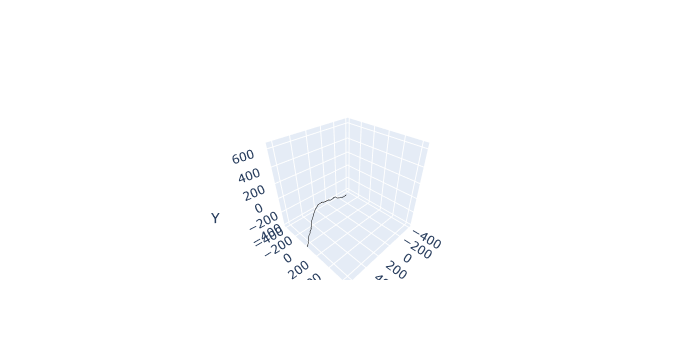

In [11]:
axon = morpho.subtree(["axon"])
plot_morphology(axon);

You can take a look at the available [operations](https://bsb.readthedocs.io/en/latest/morphologies/intro.html#subtree-transformations) and play around: 

from scipy.spatial.transform import Rotation

rot = Rotation.from_euler("y", 90, degrees=True)
axon.root_rotate(rot)
plot_morphology(morpho);

## Adding morphologies to your cells

Let's add our morphology file to our cell type:
    
```yaml
morphologies:
- morpho.swc
cell_types:
  base_type:
    spatial:
      morphologies:
      - morpho
```

You can also give the morphology a different name, and set up a processing pipeline:

```yaml
morphologies:
- name: base_type_original
  file: morpho.swc
- name: base_type_rotated
  file: morpho.swc
  pipeline:
  - func: rotate
    rotation: [90, 0, 0]
  - center
```

You can use any of the morphology methods, or any importable function of your own as a piece of the pipeline:

1. Create ``pipeline.py``
2. Add a morphology processing function:

```python
def trim(morpho, levels=1):
  for _ in range(levels):
    for branch in morpho.branches:
      if branch.is_terminal and not branch.is_root:
        branch.detach()
```

3. Use it as ``processing.trim``:

```yaml
morphologies:
- name: trimmed_morpho
  file: morpho.swc
  pipeline:
  - processing.trim
```

or specify some parameters:

```yaml
morphologies:
- name: trimmed_morpho
  file: morpho.swc
  pipeline:
  - func: processing.trim
    levels: 2
```

As a final step, add however many morphologies with/without pipelines as you like, and assign them to the ``top_type``

## Cell connections

1. Duplicate ``layer2.yaml`` and name it ``layer2_conn.yaml``. Set the storage output to ``layer2_conn.hdf5``
2. Add the following ``connectivity`` block, to roughly intersect the morphologies of the cells:

```yaml
connectivity:
    bottom_to_top:
      strategy: bsb.connectivity.VoxelIntersection
      affinity: 0.2
      presynaptic:
        cell_types:
        - base_type
      postsynaptic:
        cell_types:
        - top_type
```

In [12]:
!bsb compile 2layer_conn.yaml --clear

In [15]:
from bsb.connectivity import ConnectionStrategy
from bsb import config
from bsb.config import types

netw = from_storage("2layer_conn.hdf5")
print("Connections made:", len(netw.get_connectivity_set("bottom_to_top")))

@config.node
class MyConnection(ConnectionStrategy):
    preference = config.attr(type=types.list(type=types.float(min=0, max=1)), required=True)
    
    def connect(self, pre, post):
        pass

Connections made: 881


# Simulation

Let's run a simulation with NEST. We begin by setting up the simulation variables:

```yaml
simulations:
  nest_1:
    simulator: nest
    resolution: 0.1
    duration: 100.0
    cell_models: {}
    connection_models: {}
    devices: {}
```

We will need to define cell models for the cell types, and connection models for the connection types we wish to simulate.

```yaml
    cell_models:
      base_type:
        neuron_model: iaf_cond_alpha
        constants:
          t_ref: 0.5
          C_m: 334
          V_th: -43
          V_reset: -69
          E_L: -59
          I_e: 800
          tau_syn_ex: 1.1
          tau_syn_in: 2.8
          g_L: 7.1
      top_type:
        neuron_model: iaf_cond_alpha
        constants:
          t_ref: 1.59
          C_m: 14.6
          V_th: -53
          V_reset: -78
          E_L: -68
          I_e: 24.05
          tau_syn_ex: 0.64
          tau_syn_in: 2
          g_L: 1.6
```

In [16]:
!bsb simulate 2layer_conn.hdf5 nest_1


              -- N E S T --
  Copyright (C) 2004 The NEST Initiative

 Version: master@7be33e046
 Built: Mar 27 2023 11:52:34

 This program is provided AS IS and comes with
 NO WARRANTY. See the file LICENSE for details.

 Problems or suggestions?
   Visit https://www.nest-simulator.org

 Type 'nest.help()' to find out more about NEST.

bottom_to_bottom: 100%|███████████████████████████| 2/2 [00:01<00:00,  1.69it/s]


# Analysis

The BSB uses Neo to collect simulation data, making it easy to export to various common neuroscience exchange formats, and to analyse with existing tools for Neo/Elephant/...

## Raster plot



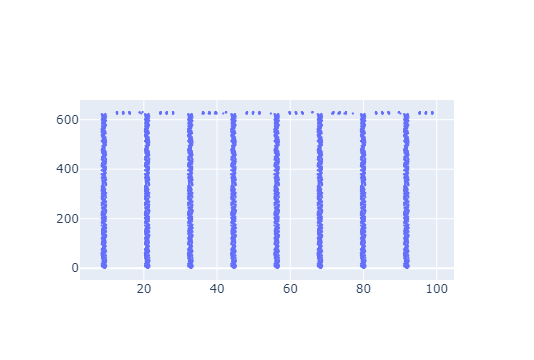

In [17]:
from neo import NixIO
import plotly.graph_objs as go

file = NixIO(filename="e0a5b81e-be55-4e12-b6bd-190f6bd66b43.nio")
sim = file.read()[0].segments[0]
scatter = ([], [])
for train in sim.spiketrains:
    scatter[0].extend(train.data)
    scatter[1].extend([train.annotations["sender"]] * len(train.data))
go.Figure(go.Scatter(
    x=scatter[0],
    y=scatter[1],
    mode="markers",
    marker_size=2,
)).show()